# Build chip extents for CNN model dev

In [1]:
import geopandas as gpd
import pandas as pd
import os, sys
sys.path.append('/home/pmontesa/code/geoscitools')
import footprintlib
import geoscilib

import matplotlib.pyplot as plt
import contextily as ctx
import re
import fiona
import math
import numpy as np
import glob

/tmp/ipykernel_402586/1258457993.py:1: UserWarning: Shapely 2.0 is installed, but because PyGEOS is also installed, GeoPandas will still use PyGEOS by default for now. To force to use and test Shapely 2.0, you have to set the environment variable USE_PYGEOS=0. You can do this before starting the Python process, or in your code before importing geopandas:

import os
os.environ['USE_PYGEOS'] = '0'
import geopandas

In a future release, GeoPandas will switch to using Shapely by default. If you are using PyGEOS directly (calling PyGEOS functions on geometries from GeoPandas), this will then stop working and you are encouraged to migrate from PyGEOS to Shapely 2.0 (https://shapely.readthedocs.io/en/latest/migration_pygeos.html).
  import geopandas as gpd


In [2]:
import fiona
fires_gdb_fn = '/explore/nobackup/projects/ilab/projects/ABoVE-Shrubs/data/alaska-fire-scars/AlaskaFireHistory_Polygons.gdb'
fiona.listlayers(fires_gdb_fn)
fires = gpd.read_file(fires_gdb_fn)

<AxesSubplot: >

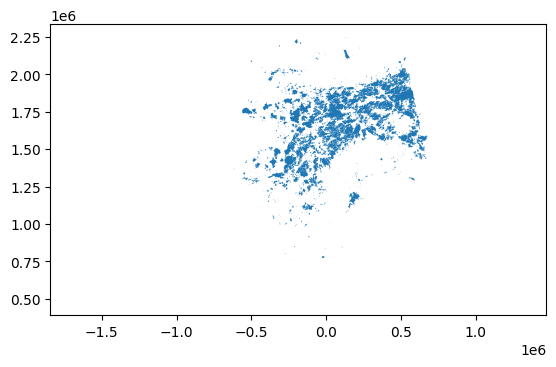

In [3]:
fires.plot()

## Read in various anti-buffered vectors - use them to mask a point grid

##### Note! Update _footprints_intersect_srlitevalid_gliht_ as more SRlite becomes available
to get valid SRLite extent see: `code/geoscitools/above_shrubs_model_plan.ipynb`

In [4]:
OUTDIR = '/explore/nobackup/people/pmontesa/userfs02/projects/ilab/above_shrubs/data/arc'

In [5]:
# file showing intersection of valid (cloudmasked) SRlite with GLiHT - this needs to be re-done b/c geometry is bad
foot_intersect_srlite_gliht_antibuf = gpd.read_file(os.path.join(OUTDIR, 'footprints_intersect_srlite_gliht_filt_antibuf_4tiles_len_256m.gpkg')) #'footprints_intersect_srlitevalid_gliht_for_tiles_buf.gpkg'))

In [43]:
# An intersection of srlite and gliht - Dont think this is usefu
#foot_intersect_srlite_gliht = gpd.read_file(os.path.join(OUTDIR, 'footprints_intersect_srlite_gliht.gpkg'))

In [6]:
# THis is the full GLiHT footprint
foot_gliht = gpd.read_file(os.path.join('/explore/nobackup/people/pmontesa/userfs02/arc/_footprints', 'footprints_gliht_13m_p50.gpkg'))

In [6]:
# This is the theoretical max are for GLiHT used for tiles of 256m in length
# When this is intersected with current SRlite then it would be used as our final mask 
foot_gliht_antibuf_256 = gpd.read_file('/explore/nobackup/people/pmontesa/userfs02/projects/ilab/above_shrubs/data/arc/footprints_gliht_antibuf_4tiles_len_256m.gpkg')

In [7]:
# This file should be the intersection of the anti-bufferred GLiHT and anti-bufferred SRlite cloudmask
# Should remove areas intersection fire polygons too
final_antibuf_vector = foot_gliht_antibuf_256

## Create points and mask with anti-buffered vector
Make a grid of points evenly spaced within an extent

In [8]:
INPUT_TILES_CRS = 3338 # Good for Alaska - need to change to something else for circumpolar

In [9]:
%%time
# point_grid_fn = '/home/pmontesa/mmacande/srlite/chm_model/alaska_points_512m/alaska_ifsar_512m_pts.shp'
# points = gpd.read_file(point_grid_fn)
spacing = 256
point_grid_fn = os.path.join(OUTDIR, f'points_grid_{spacing}_extent_gliht.gpkg')

if False:
    if not os.path.isfile(point_grid_fn):
        print('Building points grid file ...')
        points_grid = geoscilib.make_points_grid(foot_gliht.to_crs(4326), spacing, grid_crs=3338)
        points_grid.to_file(point_grid_fn, driver='GPKG')
    else:
        print('Reading points grid file and masking...')
        points_grid = gpd.read_file(point_grid_fn, mask=final_antibuf_vector)
else:
    print('Reading points grid file ...')
    points_grid = gpd.read_file(point_grid_fn)

Reading points grid file ...
CPU times: user 2h 34min 1s, sys: 8min 57s, total: 2h 42min 58s
Wall time: 4h 10min 10s


In [10]:
points_grid.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 505326388 entries, 0 to 505326387
Data columns (total 1 columns):
 #   Column    Dtype   
---  ------    -----   
 0   geometry  geometry
dtypes: geometry(1)
memory usage: 3.8 GB


In [ ]:
#points_grid.sample(frac=0.001).plot()
points_grid.head().explore()

## Intersect points_grid file with anti-buffered vector

In [8]:
#points_intersect_test = gpd.overlay(points_grid.to_crs(3857), foot_intersect_srlite_gliht_buf, how = 'intersection')

In [11]:
# srlite, gliht polys
points_intersect = gpd.overlay(points_grid.to_crs(INPUT_TILES_CRS), final_antibuf_vector.to_crs(INPUT_TILES_CRS), how = 'intersection')

In [34]:
final_antibuf_vector.crs

<Derived Projected CRS: EPSG:3995>
Name: WGS 84 / Arctic Polar Stereographic
Axis Info [cartesian]:
- X[south]: Easting (metre)
- Y[south]: Northing (metre)
Area of Use:
- name: Northern hemisphere - north of 60°N onshore and offshore, including Arctic.
- bounds: (-180.0, 60.0, 180.0, 90.0)
Coordinate Operation:
- name: Arctic Polar Stereographic
- method: Polar Stereographic (variant B)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [17]:
# fire polys
points_intersect_fires = gpd.overlay(points_intersect.to_crs(INPUT_TILES_CRS), fires.to_crs(INPUT_TILES_CRS), how = 'intersection')

In [18]:
nowtime = pd.Timestamp.now().strftime('%Y%m%d%H%M')

In [19]:
points_intersect_fires.to_file(os.path.join(OUTDIR, f'point_overlay_srlite_gliht_buf_{nowtime}.gpkg'), driver='GPKG') 

In [ ]:
# Try this: Is this the correct way of getting points intersecting polys?
within_poly_union = points_grid[points_grid.to_crs(INPUT_TILES_CRS).geometry.within(final_antibuf_vector.to_crs(INPUT_TILES_CRS).geometry.unary_union)]

In [ ]:
within_poly_union.info()

In [33]:
final_antibuf_vector['geometry'].to_crs(4326).explore(m=within_poly_union.to_crs(4326).explore())

# Read points back in

In [8]:
points_intersect_fires = gpd.read_file('/explore/nobackup/people/pmontesa/userfs02/projects/ilab/above_shrubs/data/arc/point_overlay_srlite_gliht_buf.gpkg') 

In [9]:
points_intersect_fires = points_intersect_fires.to_crs(4326)
points_intersect_fires['yearDiff'] = points_intersect_fires.year_1 - points_intersect_fires.year_2
points_intersect_fires['YEAR_FIRE'] = pd.to_datetime(points_intersect_fires.PERIMETERDATE).dt.year
points_intersect_fires['lon'] = points_intersect_fires['geometry'].centroid.x
points_intersect_fires['lat'] = points_intersect_fires['geometry'].centroid.y
points_intersect_fires['epsg'] = (32600 + np.floor((points_intersect_fires.lon + 180) / 6) + 1).astype('int64')
points_intersect_fires['utm']  = "+init=epsg:" + (points_intersect_fires['epsg']).astype('str')

/tmp/ipykernel_271275/3886020554.py:4: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  points_intersect_fires['lon'] = points_intersect_fires['geometry'].centroid.x
/tmp/ipykernel_271275/3886020554.py:5: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  points_intersect_fires['lat'] = points_intersect_fires['geometry'].centroid.y


# Create tiles
This originally handled in `code/geoscitools/srlite_filter_and_extract_chm_chips_20230515c-batch.ipynb`  
Buffer points, and replace the geometry of the gdf with the spatial envelope of each buffered point

In [10]:
def points_to_utm_tile(epsgCode, points, buf_radius_sz_m):
    '''Reproject subset of geodataframe to local UTM
        Buffer by a radius
        Get enevlope tile
    '''
    points_epsg = points[points.epsg == epsgCode].to_crs(epsgCode)
    tile_geom = points_epsg.geometry.buffer(buf_radius_sz_m).envelope
    return tile_geom

### Tiling is specific to UTM zone to match SRlite
tiles in same grid as SRlite will provide cleanest chips

In [40]:
subset_df_list = []
for epsg_code in points_intersect_fires.groupby('epsg').groups.keys():
    print('\n' , epsg_code)
    subset_points = points_intersect_fires[points_intersect_fires.epsg == epsg_code]
    subset_tiles = subset_points.copy()
    subset_tiles['geometry'] = points_to_utm_tile(epsg_code, points_intersect_fires, 128)
    subset_tiles = footprintlib.get_attributes_from_filename(subset_tiles, 'tiles for SR with GLiHT', '-toa', file_col='file_1', DROP_FILE_DUPLICATES=False)
    #print(subset_tiles.crs)
    out_tiles_fn = os.path.join(OUTDIR, f'tiles_training_gliht_srlite_256m_utm_{epsg_code}.gpkg')
    print(out_tiles_fn)
    subset_tiles.to_file(out_tiles_fn, driver='GPKG')
    subset_df_list.append(subset_tiles.to_crs(4326))
    


 32605
/explore/nobackup/people/pmontesa/userfs02/projects/ilab/above_shrubs/data/arc/tiles_training_gliht_srlite_256m_utm_32605.gpkg

 32606
/explore/nobackup/people/pmontesa/userfs02/projects/ilab/above_shrubs/data/arc/tiles_training_gliht_srlite_256m_utm_32606.gpkg

 32607
/explore/nobackup/people/pmontesa/userfs02/projects/ilab/above_shrubs/data/arc/tiles_training_gliht_srlite_256m_utm_32607.gpkg


In [27]:
tiles_utm_gdf = pd.concat(subset_df_list)

In [41]:
tiles_utm_gdf.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 6269 entries, 0 to 6238
Data columns (total 53 columns):
 #   Column             Non-Null Count  Dtype              
---  ------             --------------  -----              
 0   raster_val         6269 non-null   float64            
 1   file_1             6269 non-null   object             
 2   index              0 non-null      object             
 3   year_1             6269 non-null   int64              
 4   sensor_1           6269 non-null   object             
 5   file_2             6269 non-null   object             
 6   path               6269 non-null   object             
 7   area_km2           6269 non-null   float64            
 8   area_ha            6269 non-null   float64            
 9   sensor_2           6269 non-null   object             
 10  year_2             6269 non-null   int64              
 11  area_sqkm          6269 non-null   float64            
 12  NAME               6269 non-null   objec

<AxesSubplot: >

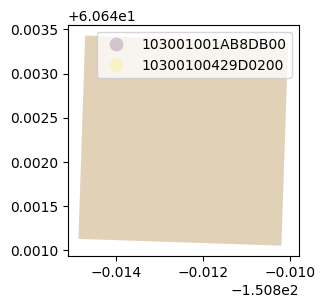

In [33]:
# Note, some tiles will have the same geometry, but attributes will be different - THIS IS A GOOD THING - provides multiple tiles of same location that have different srlite acqs
tiles_utm_gdf.head(2).plot(column='catid', cmap='viridis', alpha=0.2, legend=True, figsize=(3,3))

In [34]:
tiles_utm_gdf[["sensor_1",'file_1','file_2','yearDiff','geometry']].explore(height='50%', column="yearDiff", cmap='RdBu', vmin=-5, vmax=5,  legend=True)

In [ ]:
buf_radius_sz_m = 128 # this radius results in a square that is 256m x 256m, which is 128 x 128 in 2m srlite pixels

In [ ]:
buf_geom = points_intersect_geom.buffer(buf_radius_sz_m)

In [ ]:
tiles_geom = buf_geom.envelope

In [ ]:
tiles_intersect = points_intersect
del points_intersect

In [ ]:
tiles_intersect['geometry'] = tiles_geom
tiles_intersect.drop(['index', 'level_0'], axis=1, inplace=True)
tiles_intersect.reset_index(inplace=True)

In [ ]:
tiles_intersect.head()

In [ ]:
# Save the tiles
tiles_intersect.to_file(os.path.join(OUTDIR, f'footprints_cnn_tiles_spacing_{spacing}_buf_{buf_sz_m}.gpkg'), driver='GPKG')

In [ ]:
tiles_intersect.iloc[1].geometry.length/4

### Explore a subset of the tiles

In [564]:
xmin, xmax, ymin, ymax = [-160,-150,65,68]
#xmin, xmax, ymin, ymax = [-141.5,-140,64,65]
print(xmin, xmax, ymin, ymax)

-160 -150 65 68


In [574]:
import folium
from folium import plugins
from folium import *
# Map the Layers
Map_Figure=Figure(width=1000,height=500)
#------------------
m = Map(
    #tiles="Stamen Toner",
    tiles='',
    location=((ymin+ymax)/2, (xmin+xmax)/2),
    zoom_start=7, 
    control_scale = True
)
Map_Figure.add_child(m)
# Get a basemap
tiler_basemap_googleterrain = 'https://mt1.google.com/vt/lyrs=p&x={x}&y={y}&z={z}'
tiler_basemap_gray = "http://services.arcgisonline.com/ArcGIS/rest/services/Canvas/World_Light_Gray_Base/MapServer/tile/{z}/{y}/{x}"
tiler_basemap_image = 'https://services.arcgisonline.com/arcgis/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}'
basemaps = {
'Google Terrain' : TileLayer(
tiles = tiler_basemap_googleterrain,
attr = 'Google',
name = 'Google Terrain',
overlay = False,
control = True
),
'basemap_gray' : TileLayer(
    tiles=tiler_basemap_gray,
    opacity=1,
    name="ESRI gray",
    attr="MAAP",
    overlay=False
),
'Imagery' : TileLayer(
    tiles=tiler_basemap_image,
    opacity=1,
    name="ESRI imagery",
    attr="MAAP",
    overlay=False
),
'ESRINatGeo' : TileLayer(
tiles='https://server.arcgisonline.com/ArcGIS/rest/services/NatGeo_World_Map/MapServer/tile/{z}/{y}/{x}',
opacity=1,
name='ESRI Nat. Geo.',
attr='ESRI',
overlay=False
)
}

basemaps['ESRINatGeo'].add_to(m)
basemaps['basemap_gray'].add_to(m)
basemaps['Imagery'].add_to(m)

In [575]:
style_gliht = {'fillColor': 'black', 'color': 'black','fillOpacity': 0.25}
style_gliht_srlite = {'fillColor': 'blue', 'color': 'blue','fillOpacity': 0.25}
style_gliht_srlite_buf = {'fillColor': 'green', 'color': 'green','fillOpacity': 0.25}

In [576]:
# foot_gliht_layer = GeoJson(
#             data=foot_gliht.to_crs("4326").cx[xmin:xmax, ymin:ymax].to_json(),
#             name="GLiHT extents",
#             style_function=lambda x:style_gliht
#         )
# foot_gliht_layer.add_to(m)
m = foot_gliht.to_crs("4326").cx[xmin:xmax, ymin:ymax].to_crs(3857).explore(m=m, name="GLiHT extents", style_kwds=style_gliht)

In [577]:

# foot_intersect_srlite_gliht_layer = GeoJson(
#             data=foot_intersect_srlite_gliht.to_crs("4326").cx[xmin:xmax, ymin:ymax].to_json(),
#             name="GLiHT & SRlite intersection extents",
#             style_function=lambda x:style_gliht_srlite
#         )
# foot_intersect_srlite_gliht_layer.add_to(m)
#m = foot_intersect_srlite_gliht.to_crs("4326").cx[xmin:xmax, ymin:ymax].to_crs(3857).explore(m=m, name="GLiHT & SRlite intersection extents", style_kwds=style_gliht_srlite)

In [578]:
# foot_intersect_srlite_gliht_buf_layer = GeoJson(
#             data=foot_intersect_srlite_gliht_buf.to_crs("4326").cx[xmin:xmax, ymin:ymax].to_json(),
#             name="GLiHT & SRlite intersections buf'd: candidate extents for tiles",
#             style_function=lambda x:style_gliht_srlite_buf
#         )
# foot_intersect_srlite_gliht_buf_layer.add_to(m)
m = foot_intersect_srlite_gliht_buf.to_crs("4326").cx[xmin:xmax, ymin:ymax].to_crs(3857).explore(m=m, name="GLiHT & SRlite intersections buf'd: candidate extents for tiles", style_kwds=style_gliht_srlite_buf)

In [579]:
# points_intersect_layer = GeoJson(
#             data=points_intersect.to_crs("4326").cx[xmin:xmax, ymin:ymax].to_json(),
#             name="Candidate extents for tiles",
#             style_function=lambda x:dict(color="red")
#         )
# points_intersect_layer.add_to(m)

In [580]:
#m=pointdf.cx[xmin:xmax, ymin:ymax].cx[:, 65:].explore(m=m, name="Point grid", style_kwds=dict(color="yellow"))

In [581]:
m = points_intersect.to_crs("4326").cx[xmin:xmax, ymin:ymax].to_crs(3857).explore(m=m, name="CNN training tiles", style_kwds=dict(color="red"))

In [ ]:
folium.LayerControl().add_to(m)
plugins.Geocoder(position='bottomright').add_to(m)
plugins.Fullscreen(position='bottomleft').add_to(m)
plugins.MousePosition().add_to(m)
m

In [8]:
import numpy as np

def make_points_grid(extent_df, spacing_m, grid_crs=3857):
    
    x_spacing = spacing_m #The point spacing you want
    y_spacing = spacing_m

    xmin, ymin, xmax, ymax = extent_df.to_crs(grid_crs).total_bounds #Find the bounds of all polygons in the df
    xcoords = [c for c in np.arange(xmin, xmax, x_spacing)] #Create x coordinates
    ycoords = [c for c in np.arange(ymin, ymax, y_spacing)] #And y

    coordinate_pairs = np.array(np.meshgrid(xcoords, ycoords)).T.reshape(-1, 2) #Create all combinations of xy coordinates
    geometries = gpd.points_from_xy(coordinate_pairs[:,0], coordinate_pairs[:,1]) #Create a list of shapely points

    pointdf = gpd.GeoDataFrame(geometry=geometries, crs=grid_crs).to_crs(4326) #Create the point df
    
    return pointdf
